In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"   
import sys
BASE_PATH = os.path.join(
   '/home/tzhouaq/ManGO_MOO/'
)
sys.path.append(BASE_PATH)
sys.path.append(os.path.join(BASE_PATH, 'off_moo_baselines'))
import logging
import numpy as np
import torch
from matplotlib import pyplot as plt
import pandas as pd 
import datetime 
import json 
import copy
import wandb
CONDITIONAL_TASKS = []
 
import off_moo_bench as ob
from mango_utliz import save_uncon_results, plot_scatter, plot_line,  save_indicators, get_best_result, get_device
from end2end_diffusion.SDE import DiffusionMOO
from utils import set_seed
from off_moo_baselines.end2end.nets import End2EndMultiHeadModel
from off_moo_baselines.end2end.trainer import get_trainer
from off_moo_baselines.end2end.surrogate_problem import End2EndSurrogateProblem
from off_moo_baselines.data import tkwargs, get_dataloader
from off_moo_bench.task_set import *
 

Auto Configuration Succeed!, Using database /home/tzhouaq/ManGO_MOO/off_moo_bench/problem/mo_nas/database.
Configuration Succeed!
Auto Configuration Succeed!, Using database /home/tzhouaq/ManGO_MOO/off_moo_bench/problem/mo_nas/database.


/home/tzhouaq/anaconda3/envs/mango4moo/lib/python3.8/site-packages/sklearn/utils/multiclass.py:13: DeprecationWarning: Please use `spmatrix` from the `scipy.sparse` namespace, the `scipy.sparse.base` namespace is deprecated.
  from scipy.sparse.base import spmatrix


/home/tzhouaq/ManGO_MOO/off_moo_bench/problem/lambo/data/experiments/test/regex_problem.pkl


wandb: WARNING W&B installed but not logged in.  Run `wandb login` or set the WANDB_API_KEY env variable.
wandb: WARNING W&B installed but not logged in.  Run `wandb login` or set the WANDB_API_KEY env variable.


In [2]:
from utils import process_args 
sys.argv = ['--model=End2End', '--train_mode=Vallina','--task=re41','--use_wandb=False','--n_epochs=10','--retrain_model=False','--seed=1000']
config = process_args(return_dict=True)

results_dir = os.path.join('/home/tzhouaq/ManGO_MOO/', "results")
model_save_dir = os.path.join('/home/tzhouaq/ManGO_MOO/', "model")
 
config["results_dir"] = results_dir
config["model_save_dir"] = model_save_dir
config["data_pruning"] = True
config['data_preserved_ratio']= 1.0
config['hidden_size']=2048
config['inverse_lr']=1e-4
# config['batch_size']= 16
config['inverse_lr_decay']=0.98
config['n_epochs']= 200

config['simple_clip']=True
config['debais']=True
config["record_hist"]=False
config['dropout']=0. 
config['augment']=True
config['condition_training']=False
config['model_ckpt'] = None 
# config['normalize_xs'] = False
# config['normalize_ys'] = False

All config: {'results_dir': './results', 'model_save_dir': './model', 'use_wandb': False, 'run_type': 'train', 'seed': 1000, 'retrain_model': False, 'num_solutions': 256, 'solver_n_gen': 50, 'solver_init_method': 'nds', 'model': 'End2End', 'train_mode': 'Vallina', 'task': 're41', 'n_epochs': 10, 'data_pruning': False, 'batch_size': 128, 'forward_lr': 0.001, 'forward_lr_decay': 0.98, 'normalize_xs': True, 'normalize_ys': True, 'to_logits': False, 'record_hist': True}


In [3]:
# initialise task
if config["task"] in ALLTASKSDICT.keys():
    config["task"] = ALLTASKSDICT[config["task"]]

results_dir = os.path.join(config['results_dir'], 
                            f"{config['model']}-{config['train_mode']}-{config['task']}")
config["results_dir"] = results_dir 

ts = datetime.datetime.utcnow() + datetime.timedelta(hours=+8)
ts_name = f"-ts-{ts.year}-{ts.month}-{ts.day}_{ts.hour}-{ts.minute}-{ts.second}"
run_name = f"Ours-{config['model']}-{config['train_mode']}-seed{config['seed']}-{config['task']}"

logging_dir = os.path.join(config['results_dir'], run_name + ts_name)
os.makedirs(logging_dir, exist_ok=True)

if config['use_wandb']:
    if 'wandb_api' in config.keys():
        wandb.login(key=config['wandb_api'])

    wandb.init(
        project="ManGO_MOO",
        name=run_name + ts_name,
        config=config,
        group=f"{config['model']}-{config['train_mode']}",
        job_type=config['run_type'],
        mode="online",
        dir=os.path.join(config['results_dir'], '..')
    )

with open(os.path.join(logging_dir, "params.json"), "w") as f:
    json.dump(config, f, indent=4)

set_seed(config['seed'])
os.environ["SEED"] = f"{config['seed']}"

task = ob.make(config['task'])
x_min, x_max, y_min, y_max = task.dataset.get_xy_min_max()
x_lbound = x_min#task.problem.xl
x_ubound = x_max#task.problem.xu
print('x_min:', x_min, '\n', 'x_max:',x_max, '\n','y_min:',y_min,'\n', 'y_max:',y_max)
print('x_lbound:', x_lbound, '\n', 'x_ubound:',x_ubound)


x_min: [0.50005394 0.45000029 0.50017438 0.50002373 0.87524414 0.40003172
 0.40023116] 
 x_max: [1.49990833 1.34997737 1.49999217 1.49994018 2.62493353 1.19992818
 1.19979327] 
 y_min: [15.87368122  3.58726077 10.6748894   0.        ] 
 y_max: [42.64892315  4.42692892 13.07735381 13.44858932]
x_lbound: [0.50005394 0.45000029 0.50017438 0.50002373 0.87524414 0.40003172
 0.40023116] 
 x_ubound: [1.49990833 1.34997737 1.49999217 1.49994018 2.62493353 1.19992818
 1.19979327]


In [4]:
#There are some issues with the normalization implemented by benchmark. Here, let's avoid them to obtaine X and Y directly.
X = task.x.copy()
y = task.y.copy()
 
X_test = copy.deepcopy(task.x_test)
y_test = copy.deepcopy(task.y_test)

len_data = task.x.shape[0]
if config["data_pruning"]:
    X, y = task.get_N_non_dominated_solutions(
        N=int(len_data * config["data_preserved_ratio"]),
        return_x=True, return_y=True
    )

if config['to_logits']:
    assert task.is_discrete 
    task.map_to_logits()
    X = task.to_logits(X)
    X_test = task.to_logits(X_test)
if config['normalize_xs']:
    task.map_normalize_x()
    # X = copy.deepcopy(X)
    X = task.normalize_x(X)
    X_test = task.normalize_x(X_test)
    x_lbound = task.normalize_x(x_lbound)
    x_ubound = task.normalize_x(x_ubound)
    x_min = task.normalize_x(x_min)
    x_max = task.normalize_x(x_max)
pf = task.problem.get_pareto_front() 
if config['normalize_ys']:
    task.map_normalize_y()
    y = task.normalize_y(y)
    y_test = task.normalize_y(y_test)
    pf = task.normalize_y(pf)
    y_min = task.normalize_y(y_min)
    y_max = task.normalize_y(y_max)

if config['to_logits']:
    data_size, n_dim, n_classes = tuple(X.shape)
    X = X.reshape(-1, n_dim * n_classes)
    X_test = X_test.reshape(-1, n_dim * n_classes)
else:
    data_size, n_dim = tuple(X.shape)
n_obj = y.shape[1]

X.shape, y.shape, X_test.shape, y_test.shape


((60000, 7), (60000, 4), (40000, 7), (40000, 4))

In [5]:
#This cell is to train or load the forward model
config['retrain_model']=False
config['n_epochs']= 200
config['batch_size']= 32
config["train_mode"] = "gradnorm"
config["gradient_alpha"] = 0.12
model_save_dir = config['model_save_dir']
config["weight_lr"] = 5e-4
config['weight_lr_decay']=0.99
model_save_dir = config['model_save_dir']
os.makedirs(model_save_dir, exist_ok=True)

model_save_path = os.path.join(
    model_save_dir,
    f"{config['model']}-{config['train_mode']}-{config['task']}-{config['seed']}.pt"
)
model = End2EndMultiHeadModel(
    n_dim=n_dim * n_classes if config['to_logits'] else n_dim,
    n_obj=n_obj,
    hidden_size=[2048, 2048],
    save_path=model_save_path,
).to(**tkwargs)

trainer_func = get_trainer(config["train_mode"])

trainer = trainer_func(
    forward_model=model, 
    config=config
)

(
    train_loader,
    val_loader,
    test_loader
) = get_dataloader(X, y, X_test, y_test,
                    val_ratio=0.01,
                    batch_size=config["batch_size"])

trainer.launch(
    train_loader,
    val_loader,
    test_loader,
    retrain_model=config["retrain_model"]
)


#attain the surrogate model
surrogate_problem = End2EndSurrogateProblem(
    n_var=n_dim * n_classes if config['to_logits'] else n_dim, n_obj=n_obj, model=model
)

 

Successfully load trained model from /home/tzhouaq/ManGO_MOO/model/End2End-gradnorm-RE41-Exact-v0-1000.pt with valid MSE = 0.00031695779762230814


In [ ]:
from end2end_diffusion.mango_training import mango_train

print(config['inverse_lr'])
CONDITIONAL_TASKS = []
# torch.set_default_dtype(torch.float32)
 
if config['augment']:

    clip_min = torch.tensor(np.concatenate((x_lbound, y_min)))
    clip_max = torch.tensor(np.concatenate((x_ubound, y_max)))
else:
    clip_min = torch.tensor(x_min)
    clip_max = torch.tensor(x_max)

clip_dic = {'simple_clip': config['simple_clip'], 'clip_min': clip_min , 'clip_max': clip_max}
print(clip_dic)

try:
    inverse_model
except NameError:
    inverse_model = None   

# inverse_model = None
# config['n_epochs']=400
# # # # # clip_dic['simple_clip']=True
# inverse_model = mango_train(
#     task=task,
#     X=X,
#     y=y,
#     forward_model=model,
#     inverse_model=inverse_model,
#     hidden_size=config['hidden_size'],
#     lr=config['inverse_lr'],
#     dropout=config['dropout'],
#     device='auto',
#     seed=config['seed'],
#     num_epochs= config['n_epochs'],
#     ckpt_dir=config['model_save_dir'],
#     score_matching=True,
#     # data_preserved_ratio=config['data_preserved_ratio'],  
#     clip_dic=clip_dic,
#     # debais=config['debais'],
#     augment=config['augment'],
#     condition_training=config['condition_training']
# )


0.0001
{'simple_clip': True, 'clip_min': tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], dtype=torch.float64), 'clip_max': tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], dtype=torch.float64)}


In [ ]:
# load the pretrained model
model_ckpt = '/home/tzhouaq/ManGO_MOO/model/ours-re41-seed1000-hidden2048-score_matchingTrue.ckpt' 

inverse_model = DiffusionMOO.load_from_checkpoint(
    model_ckpt,
    taskname=task.dataset_name,
    task=task,
    learning_rate=config['inverse_lr'],
    dropout_p=config['dropout'],
    hidden_size=config['hidden_size'],
    simple_clip=clip_dic['simple_clip'],
    clip_min= clip_dic['clip_min'],
    clip_max= clip_dic['clip_max'],
    debais=config['debais'],
    augment=config['augment'],
    forwardmodel=model,
    condition_training=False
)



uncondition_training T: {1.0}


{'simple_clip': True, 'clip_min': tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], dtype=torch.float64), 'clip_max': tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], dtype=torch.float64)}
Hypervolume (100th): 15.986878
Ideal Hypervolume: 23.425600
L2 dist between design score and given y: 9.48553693008366
L2 dist between generated and given y: 9.43221312272751
Best design is: 
 [0.9554216  0.8925331  0.9686386  0.77978975 0.8910176  0.67710346
 0.1729533  0.8500447  0.17697185 0.27127528 0.        ]
Best design score is: 
 [0.85090085 0.17045681 0.26818441 0.        ]
Best design score in training set: 
 [0.9623158  0.02598313 0.08120793 0.        ]
Oracle design score is: 
 [1.11511476e-10 1.10677607e-09 1.76097427e-09 0.00000000e+00]
Distance between the best to oracle value in training set is :
 0.9660856846350429
Distance between the best to oracle value is :
 0.9083009722005214
Hypervolume (100th): 16.186469
Hypervolume (75th): 16.160886
Hypervolume (50th): 14.956350
Hyper

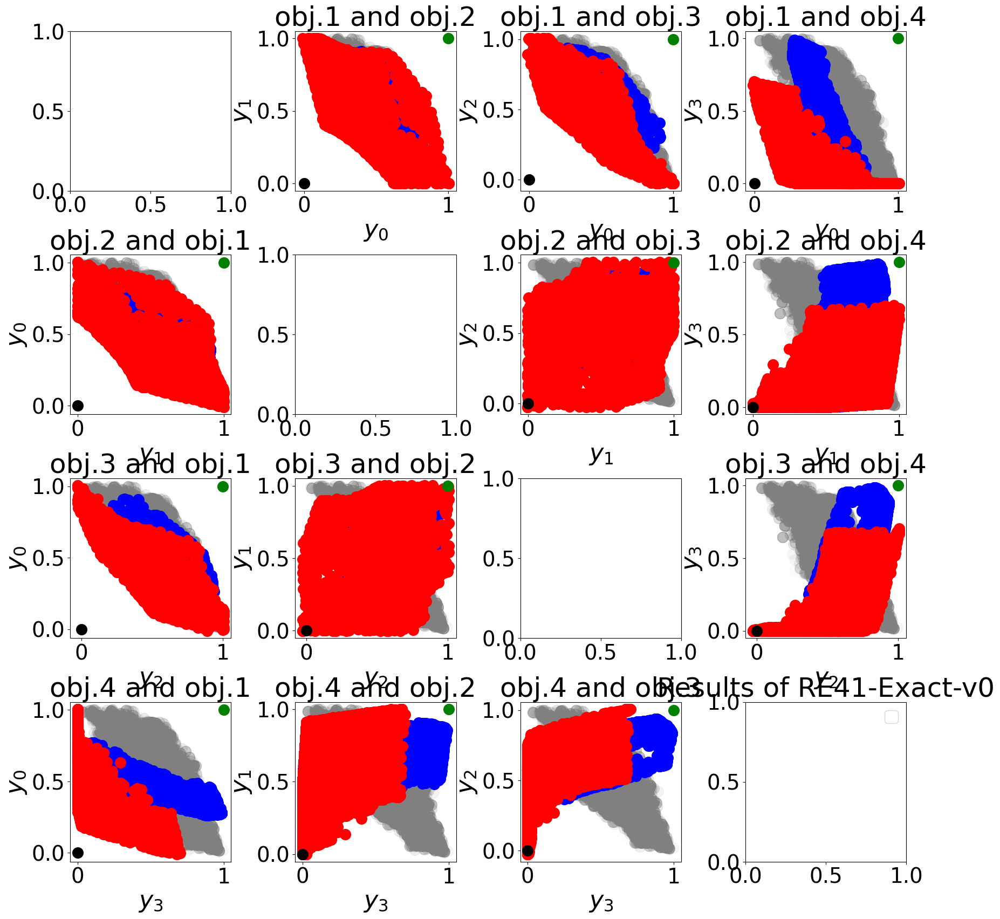

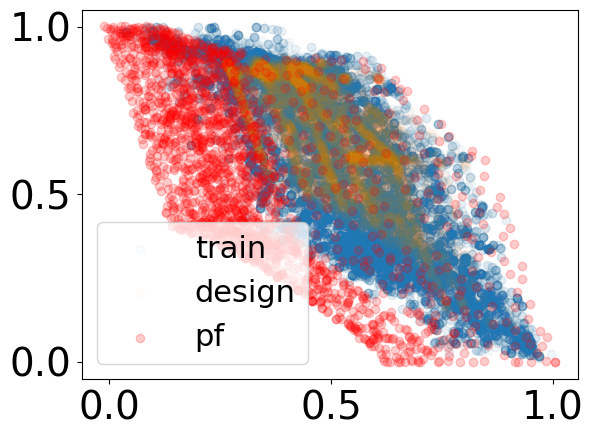

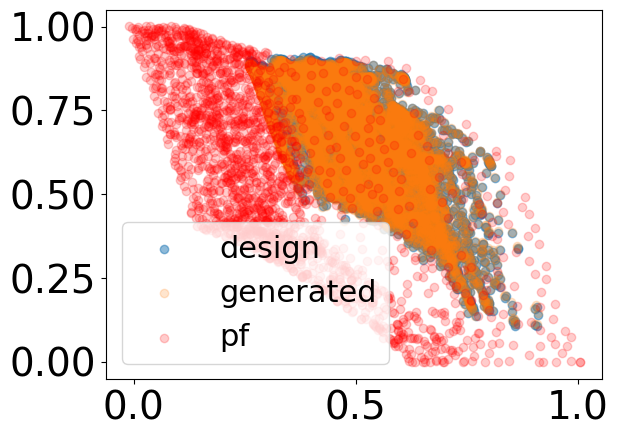

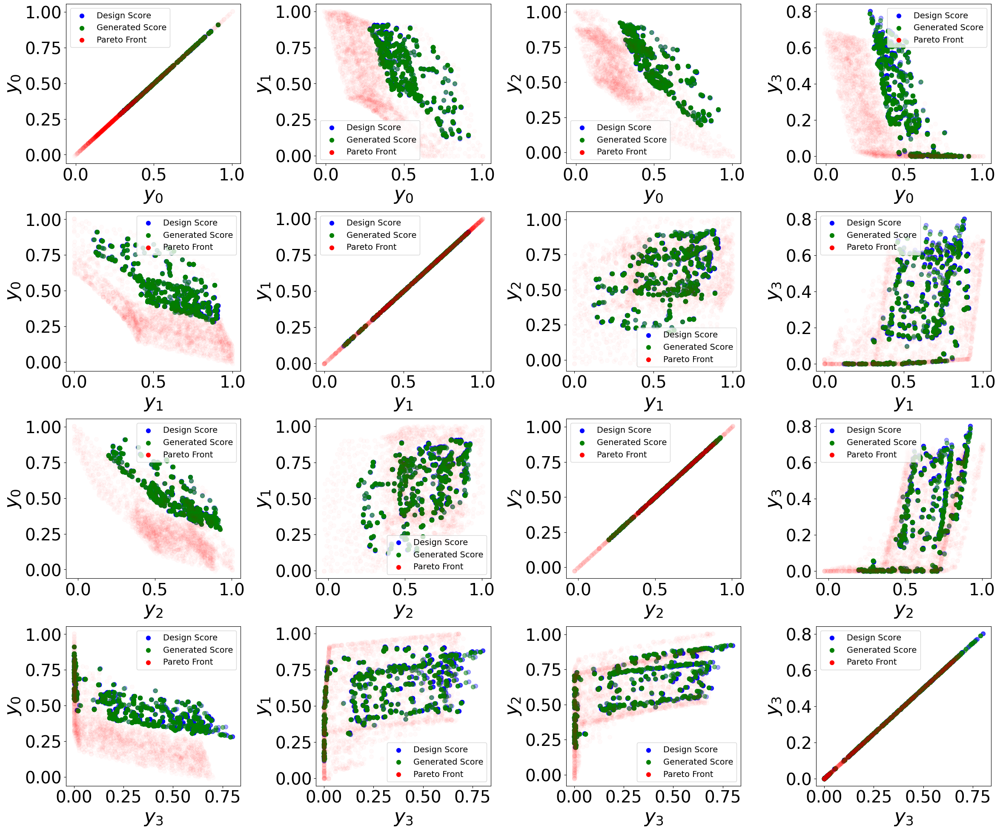

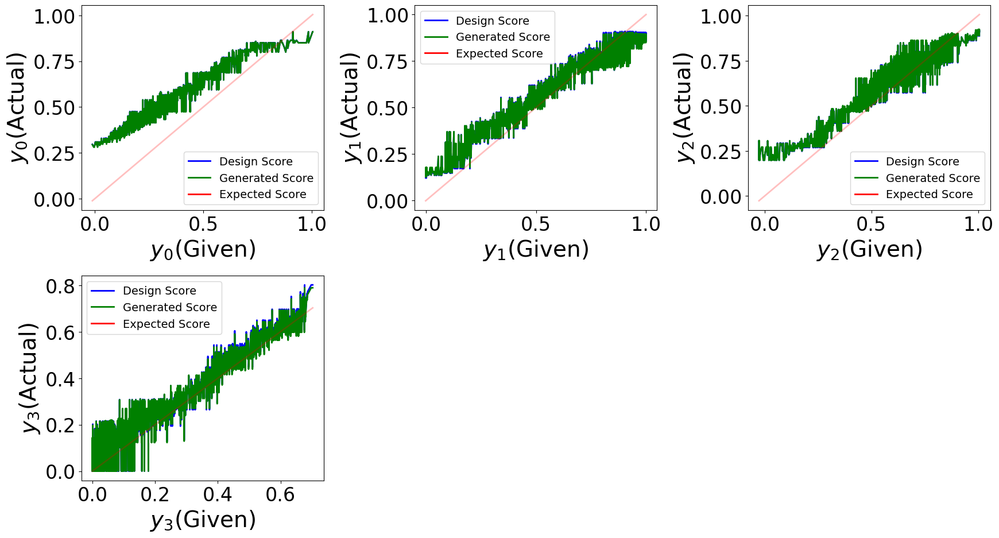

In [ ]:
#This cell is to conduct unconditional generation 
from end2end_diffusion.mango_eval_is import mango_eval, fixed_random_seed

if config['augment']:
    pf = task.problem.get_pareto_front() 
    if config['normalize_ys']:
        pf = task.normalize_y(pf)
    y_min = np.minimum(y_min, pf.min(axis=0))
    y_max = np.maximum(y_max, pf.max(axis=0))
    clip_min = torch.tensor(np.concatenate((x_min, y_min)))#x_lbound
    clip_max = torch.tensor(np.concatenate((x_max, y_max)))#x_ubound
else:
    clip_min = torch.tensor(x_min)
    clip_max = torch.tensor(x_max)
print(clip_dic)

num_samples = 1000 
 
res = mango_eval(
    task=task,
    forwardmodel=model,
    inverse_model=inverse_model,
    device='auto',
    num_samples=num_samples,
    logging_dir=logging_dir,
    ckpt_dir=config['model_save_dir'],
    augment=config['augment'],
    clip_dic=clip_dic,
    # gamma=0,
    condition_training=config['condition_training'],
    # gen_condition=y_given,
    num_steps=1000
    
    # guidance=True
)

res_x, res_y, y_cand, y_gen, y_given_list = save_uncon_results(res, task, config, model, logging_dir, X, y)

pf = task.problem.get_pareto_front()
if config['normalize_ys']:
    pf = task.normalize_y(pf)

plt.scatter(y[:,0],y[:,1],label='train',alpha=0.02)
plt.scatter(res_y[:,0],res_y[:,1],label='design',alpha=0.02)
# plt.scatter(y_test[:,0],y_test[:,1],label='test',alpha=0.02)
plt.scatter(pf[:,0],pf[:,1],label='pf',color='r',alpha=0.2)
plt.legend()
plt.show()
y_dim = task.y.shape[-1]
plt.scatter(res_y[:,0],res_y[:,1],label='design',alpha=0.5)
plt.scatter(res_x[:,-y_dim],res_x[:,-(y_dim-1)],label='generated',alpha=0.2)
plt.scatter(pf[:,0],pf[:,1],label='pf',color='r',alpha=0.2)
# plt.xlim(0,1)
# plt.ylim(0,1)
plt.legend()

#plot scatter and line
description = 'uncond'
kkk = 100
seed = 42
plot_scatter(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
plot_line(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
 

{'simple_clip': True, 'clip_min': tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.], dtype=torch.float64), 'clip_max': tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], dtype=torch.float64)}
{'simple_clip': True, 'clip_min': tensor([ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000, -0.0111,
        -0.0024, -0.0267,  0.0000], dtype=torch.float64), 'clip_max': tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0044, 1.0004,
        1.0058, 1.0000], dtype=torch.float64)}
****************************************Seed: 40*********************************************************


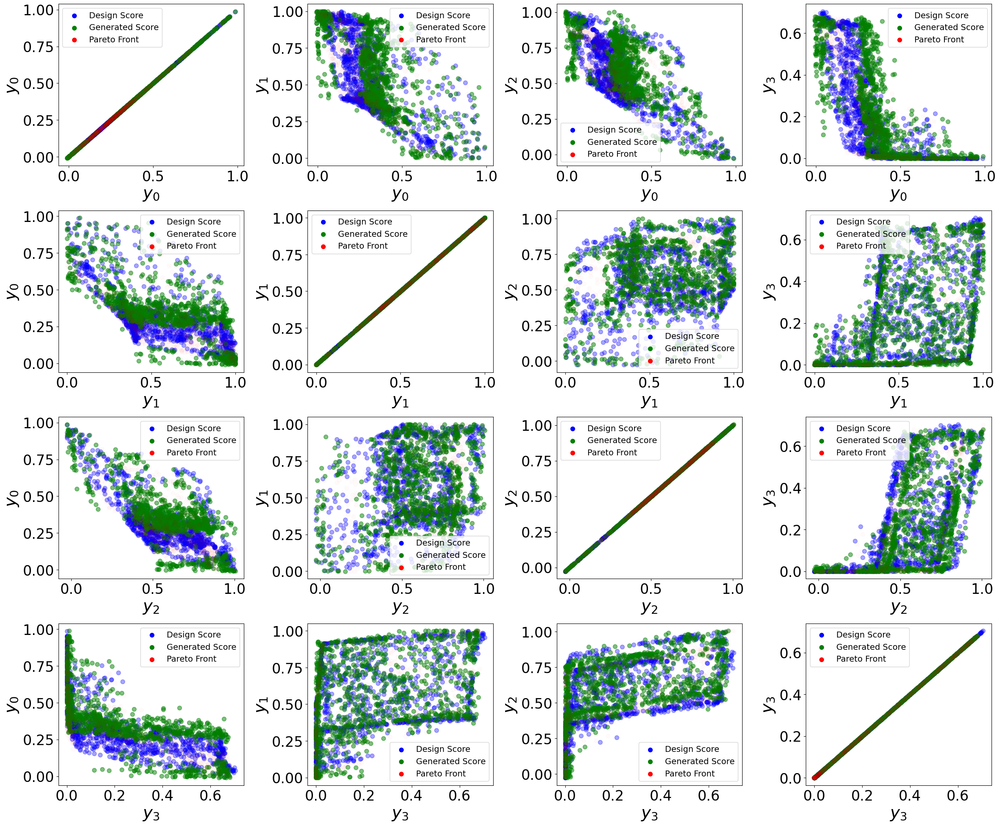

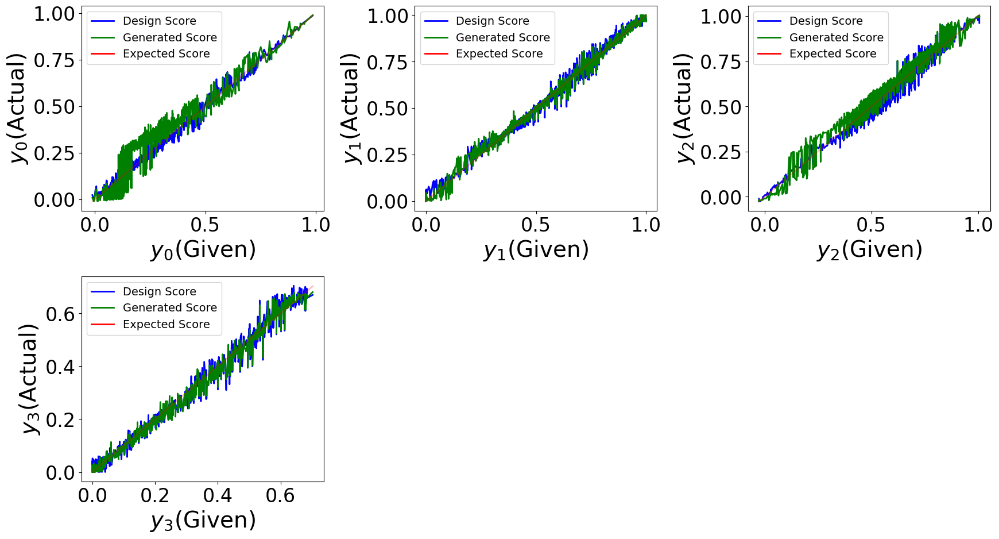

Hypervolume (100th): 21.073098
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.256394
pf Hypervolume: 21.338363
GD: 0.027865933630467736
GD+: 0.012217919052250777
IGD: 0.04624933834471396
IGD+: 0.0202677433494206
L2 dist between design score and given y: 1.2163334967652148
L2 dist between generated and given y: 2.5456217270023624
Spread for y_cand: 0.4814012970306095
Spread for y_gen: 0.47734764638944926
****************************************Seed: 41*********************************************************


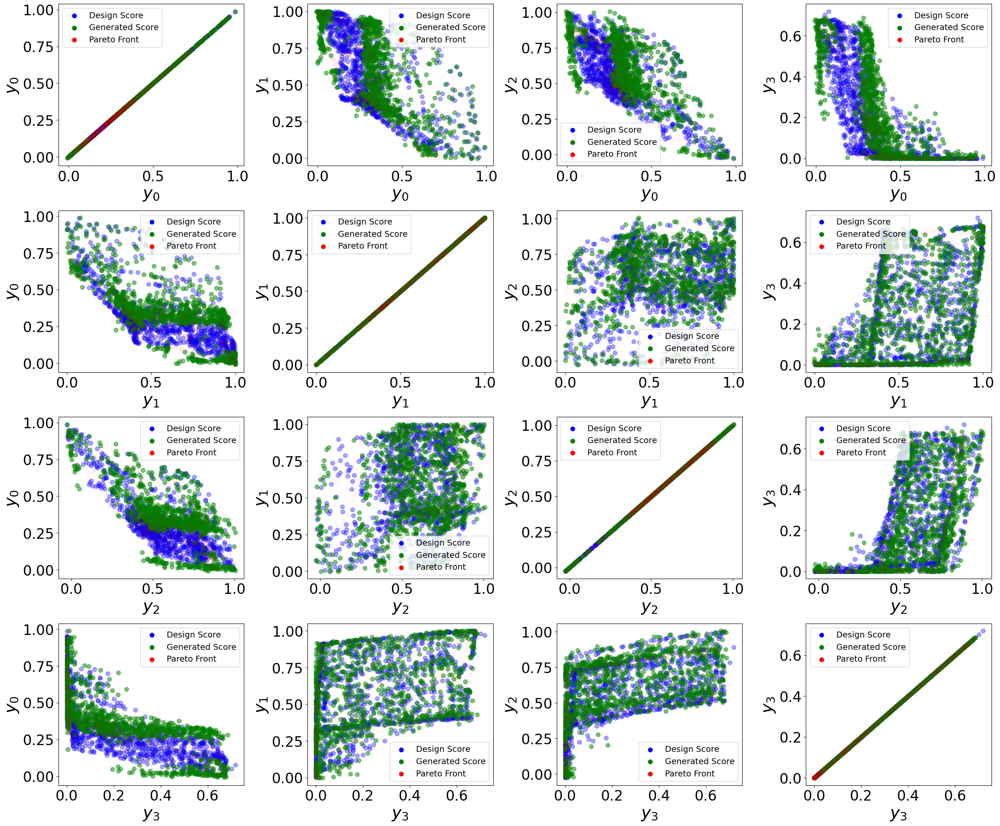

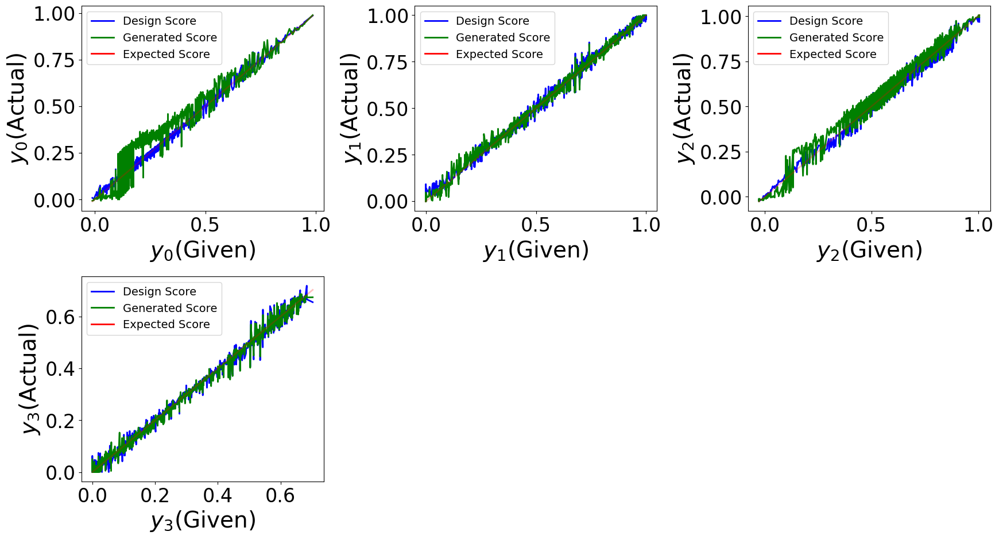

Hypervolume (100th): 21.024001
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.256394
pf Hypervolume: 21.338363
GD: 0.02595341028213835
GD+: 0.010405186295213729
IGD: 0.03942222164143758
IGD+: 0.01679337633204279
L2 dist between design score and given y: 0.8333412279241257
L2 dist between generated and given y: 2.6024365502709963
Spread for y_cand: 0.4846837475958994
Spread for y_gen: 0.47387899880840595
****************************************Seed: 42*********************************************************


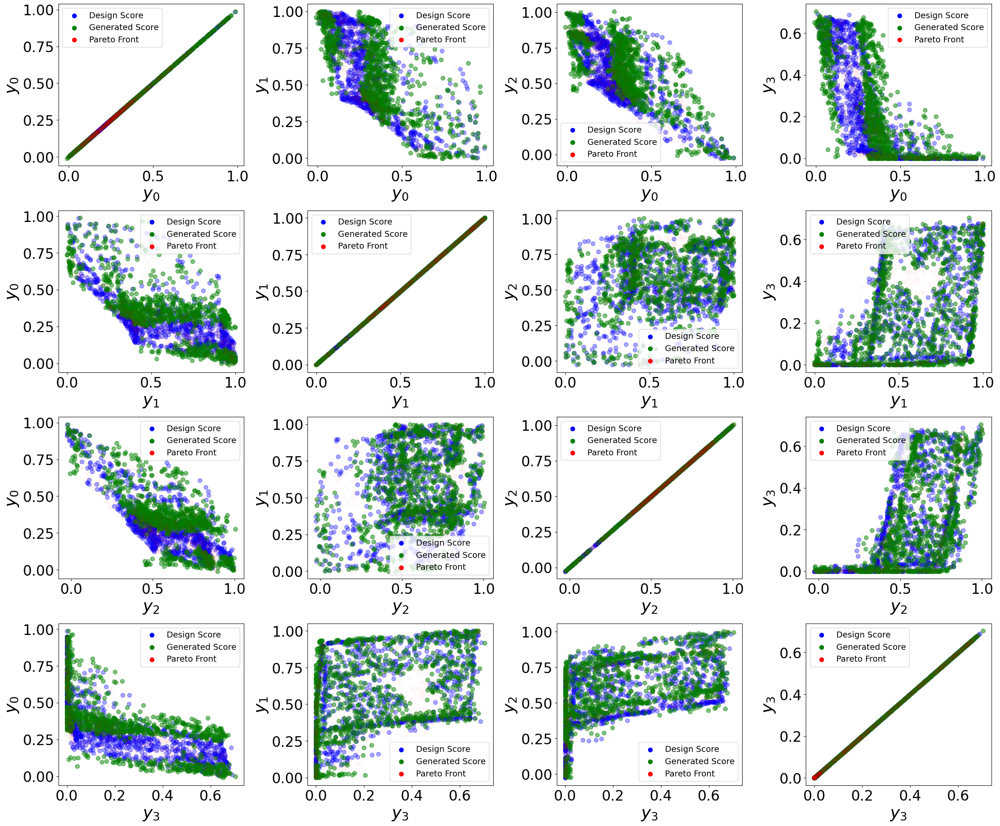

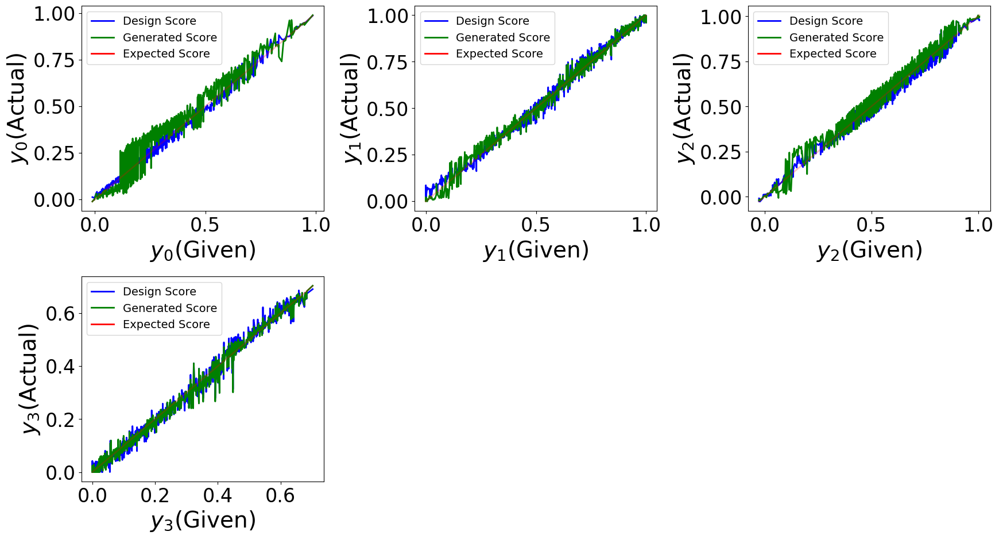

Hypervolume (100th): 21.041054
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.256394
pf Hypervolume: 21.338363
GD: 0.02689905620182973
GD+: 0.01053442362642431
IGD: 0.04258474638960118
IGD+: 0.018079045123790827
L2 dist between design score and given y: 1.0283481000181367
L2 dist between generated and given y: 2.3600713508881266
Spread for y_cand: 0.5055370094280673
Spread for y_gen: 0.46453188854239635
****************************************Seed: 43*********************************************************


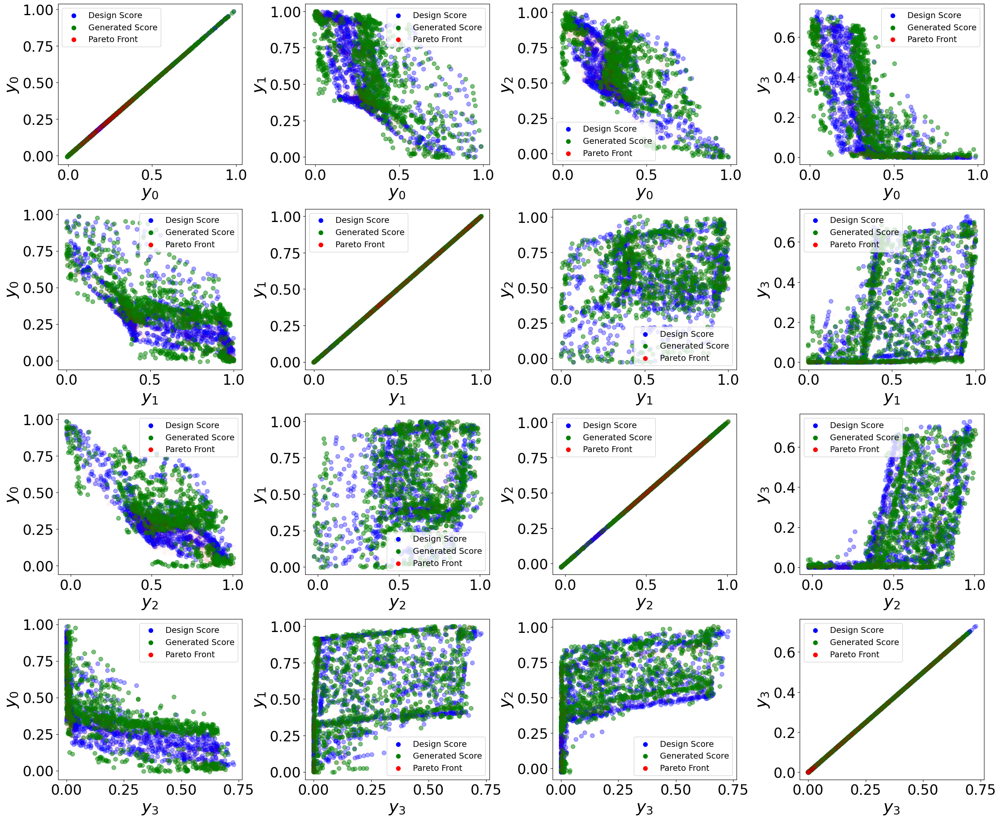

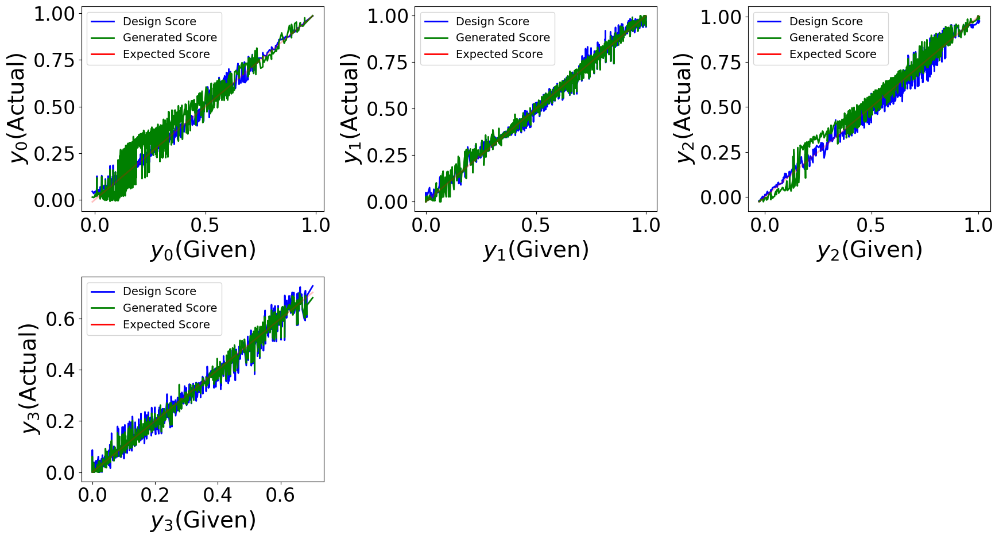

Hypervolume (100th): 20.972119
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.256394
pf Hypervolume: 21.338363
GD: 0.02982114036918928
GD+: 0.013815672660413905
IGD: 0.047148757748991986
IGD+: 0.02111576207233653
L2 dist between design score and given y: 1.2598641262009498
L2 dist between generated and given y: 2.574201822813789
Spread for y_cand: 0.5173038564185684
Spread for y_gen: 0.4681021096543847


In [ ]:
#This cell is to conduct conditional generation  with k = 256
if config['augment']:
    pf = task.problem.get_pareto_front() 
    if config['normalize_ys']:
        pf = task.normalize_y(pf)
    y_min = np.minimum(y_min, pf.min(axis=0))
    y_max = np.maximum(y_max, pf.max(axis=0))
    clip_min = torch.tensor(np.concatenate((x_min, y_min)))#x_lbound
    clip_max = torch.tensor(np.concatenate((x_max, y_max)))#x_ubound
else:
    clip_min = torch.tensor(x_min)
    clip_max = torch.tensor(x_max)
print(clip_dic)

config['simple_clip'] = True
# clip_min = - torch.ones_like(clip_min)*0.1
clip_dic = {'simple_clip': config['simple_clip'], 'clip_min': clip_min , 'clip_max': clip_max}
print(clip_dic)

# y_given_list  = np.linspace(0.1, 15, 100)
with fixed_random_seed(1000):
    if len(pf)<100:
        rand_idx = list(range(len(pf)))
    else:
        rand_idx = np.random.choice(len(pf), 1000, replace=False)
y_given_list =  pf[rand_idx]
num_samples = 1000

num_steps = 200
inference_scaling_bool = True
duplicated_time = 64
description = 'resampling_nsmc'
kkk=256

seed_list = [40, 41, 42, 43]
HV_list = []
IGD_list = []

import pickle

for seed in seed_list:
    print(f"****************************************Seed: {seed}*********************************************************")
    xy_pred = {f'{n}': None for n in range(num_samples)}
    xy_scores = {f'{n}': None for n in range(num_samples)}

    all_res = {"y_given_list":y_given_list}
    all_res['denoising_step'] = num_steps
    all_res['inference_scaling_bool'] = inference_scaling_bool
    all_res['duplicated_time'] = duplicated_time
    all_res['shot_num'] = kkk 
    all_res.update(clip_dic)

    for i in y_given_list:
        y_given = torch.tensor(i) 
        res = mango_eval(
            task=task,
            forwardmodel=model,
            inverse_model=inverse_model,
            # hidden_size=config['hidden_size'],
            device='auto',
            num_samples= config['num_solutions'],
            seed=seed,
            logging_dir=logging_dir,
            ckpt_dir=config['model_save_dir'],
            augment=config['augment'],
            clip_dic=clip_dic,
            gamma=0,
            gen_condition=y_given,
            guidance=True,
            num_steps=num_steps,
            inference_scaling_bool=inference_scaling_bool,
            duplicated_time=duplicated_time,
        )
        for num_samples1 in range(res['x'].shape[0]):
            if xy_pred[f'{num_samples1}'] is None:
                xy_pred[f'{num_samples1}'] = res['x'][num_samples1]
                # xy_scores[f'{num_samples}'] = res['y_scores'][num_samples]
            else:
                xy_pred[f'{num_samples1}'] = np.vstack((xy_pred[f'{num_samples1}'], res['x'][num_samples1]))
                # xy_scores[f'{num_samples}'] = np.vstack((xy_scores[f'{num_samples}'], res['y_scores'][num_samples]))

        all_res[f'y_given_{i}'] = res

    #save all_res
    file_path = os.path.join(logging_dir, f"cond_{description}_all_res_shot{kkk}_seed{seed}.pkl")
    with open(file_path, 'wb') as f:
        pickle.dump(all_res, f)

    #get best result
    x_opt_cand, y_cand, y_gen, valid_num = get_best_result(task, res, xy_pred, y_given_list, clip_max, clip_min, kkk, config)

    np.save(f'{logging_dir}/cond_{description}_res_x_opt_cand_shot{kkk}_seed{seed}.npy', x_opt_cand)
    np.save(f'{logging_dir}/cond_{description}_res_y_cand_shot{kkk}_seed{seed}.npy', y_cand)
    np.save(f'{logging_dir}/cond_{description}_res_y_gen_shot{kkk}_seed{seed}.npy', y_gen)
 

    #plot scatterr
    plot_scatter(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
    #plot line
    plot_line(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
    #save indicators
    save_indicators(HV_list, IGD_list, y_cand, y_gen, y_given_list, pf, description, logging_dir, kkk, seed, config, task)

In [ ]:
print(f"Average Hypervolume: {np.mean(HV_list):.4f} ± {np.std(HV_list):.4f}")
print(f"Average IGD: {np.mean(IGD_list):.4f} ± {np.std(IGD_list):.4f}")

Average Hypervolume: 21.0276 ± 0.0365
Average IGD: 0.0439 ± 0.0031


{'simple_clip': True, 'clip_min': tensor([ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000, -0.0111,
        -0.0024, -0.0267,  0.0000], dtype=torch.float64), 'clip_max': tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0044, 1.0004,
        1.0058, 1.0000], dtype=torch.float64)}
{'simple_clip': True, 'clip_min': tensor([ 0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000, -0.0111,
        -0.0024, -0.0267,  0.0000], dtype=torch.float64), 'clip_max': tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0044, 1.0004,
        1.0058, 1.0000], dtype=torch.float64)}
****************************************Seed: 40*********************************************************


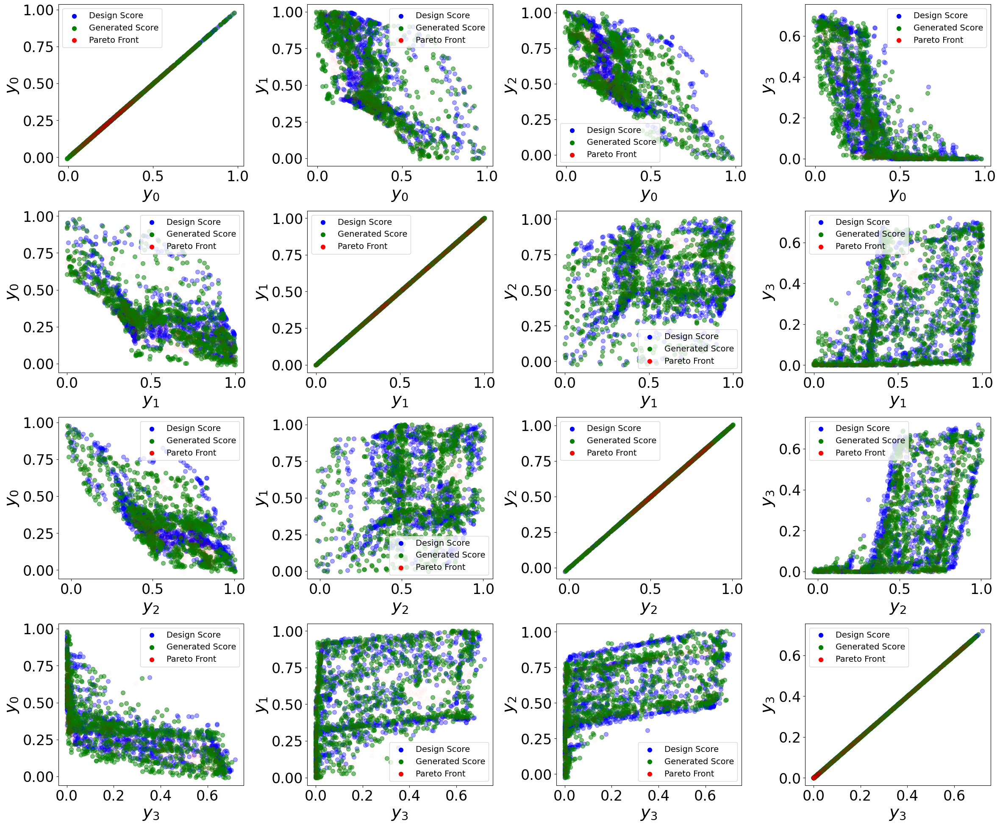

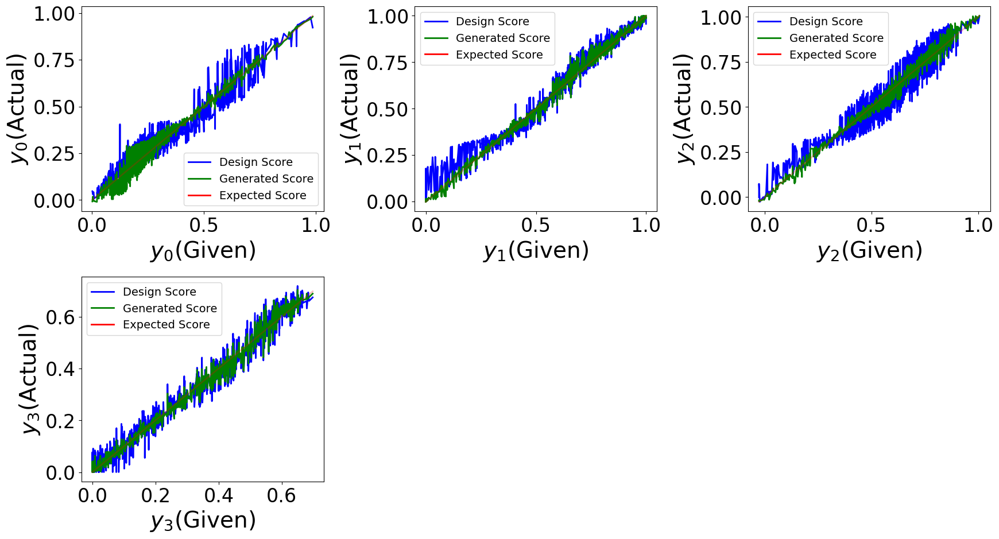

Hypervolume (100th): 20.945256
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.242877
pf Hypervolume: 21.338363
GD: 0.043583338373155825
GD+: 0.02858328802504148
IGD: 0.06077295290078021
IGD+: 0.02776136459494547
L2 dist between design score and given y: 2.419647063613922
L2 dist between generated and given y: 1.2644634660711964
Spread for y_cand: 0.5225816813089266
Spread for y_gen: 0.49873876587700133
****************************************Seed: 41*********************************************************


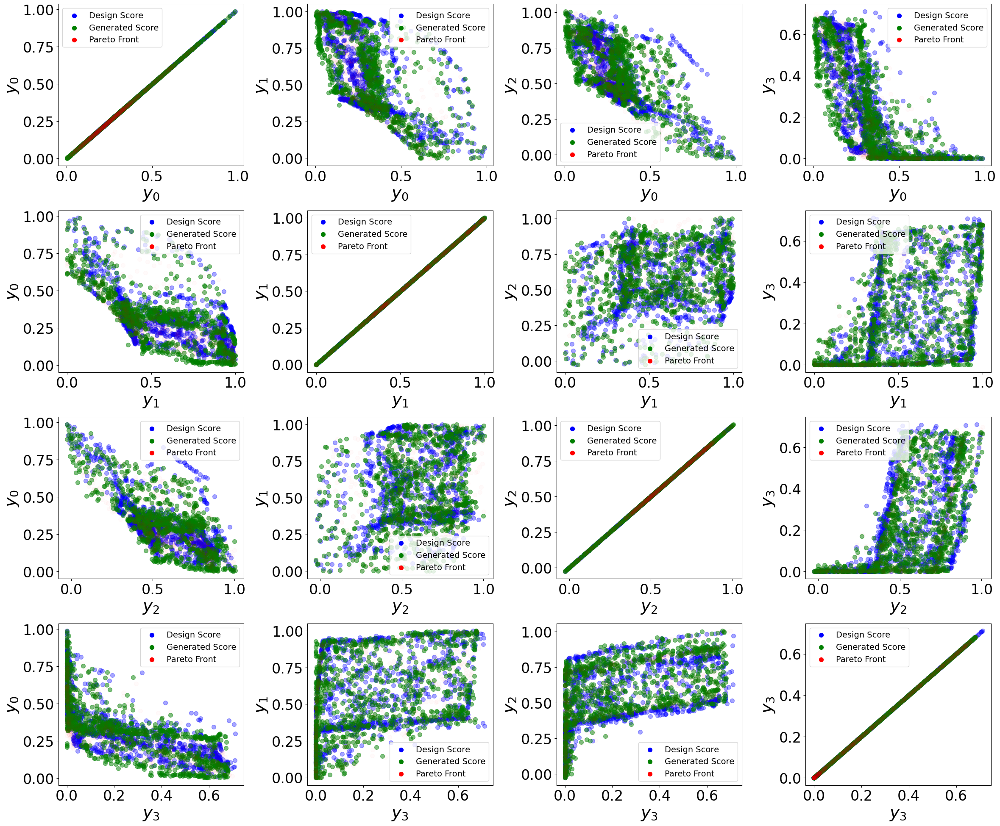

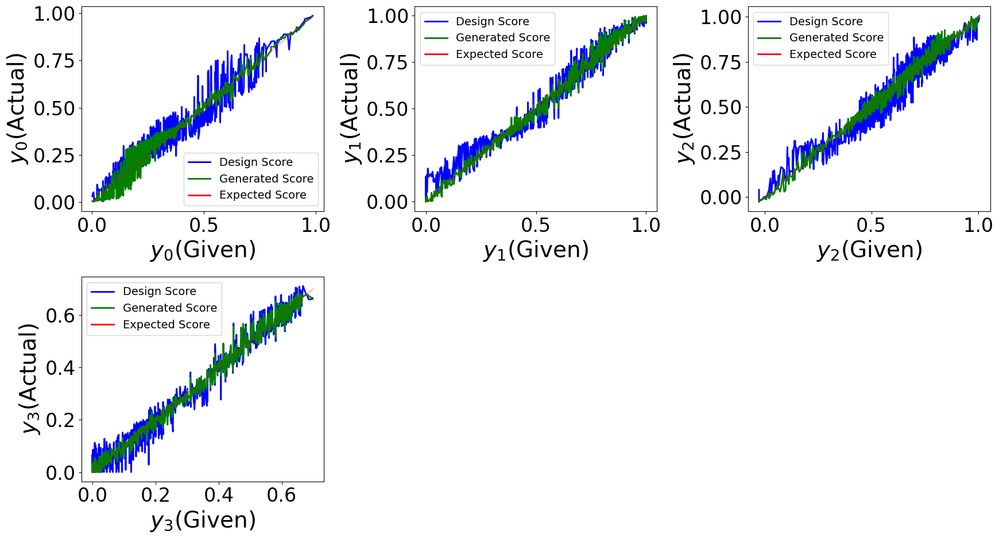

Hypervolume (100th): 20.938554
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.242877
pf Hypervolume: 21.338363
GD: 0.04074555327697591
GD+: 0.02470377242991468
IGD: 0.055710916468694575
IGD+: 0.024807195139501824
L2 dist between design score and given y: 2.224848751339471
L2 dist between generated and given y: 1.4214960385353046
Spread for y_cand: 0.5413897273354884
Spread for y_gen: 0.5024030610640067
****************************************Seed: 42*********************************************************


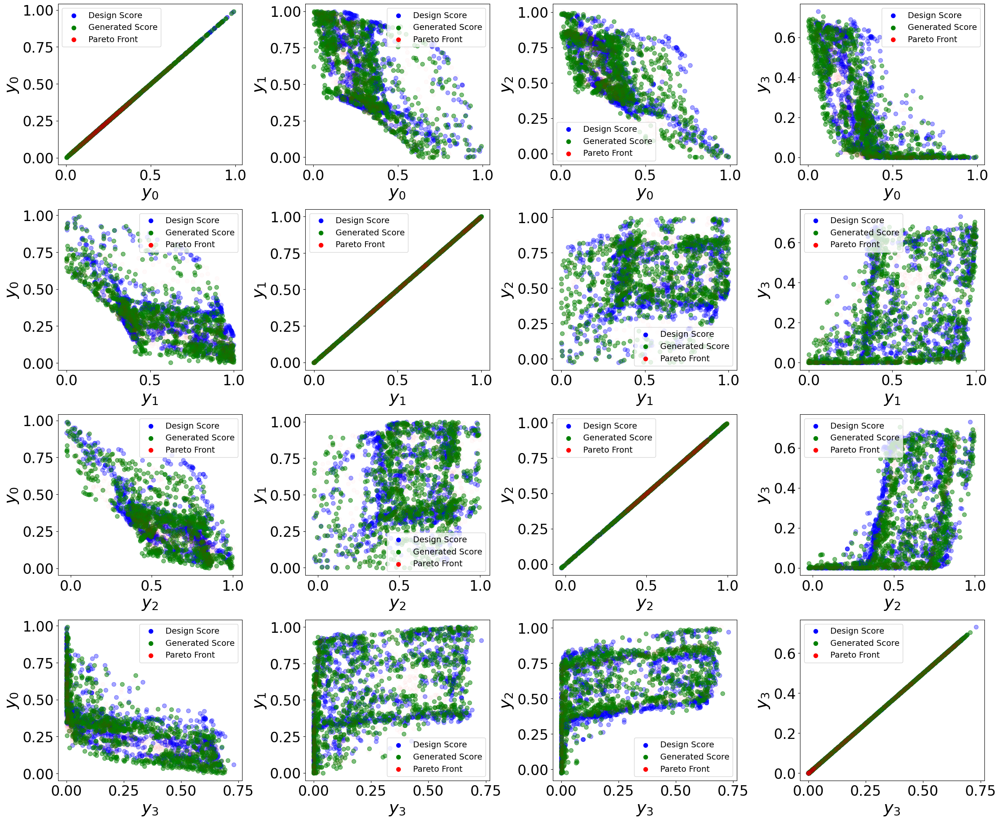

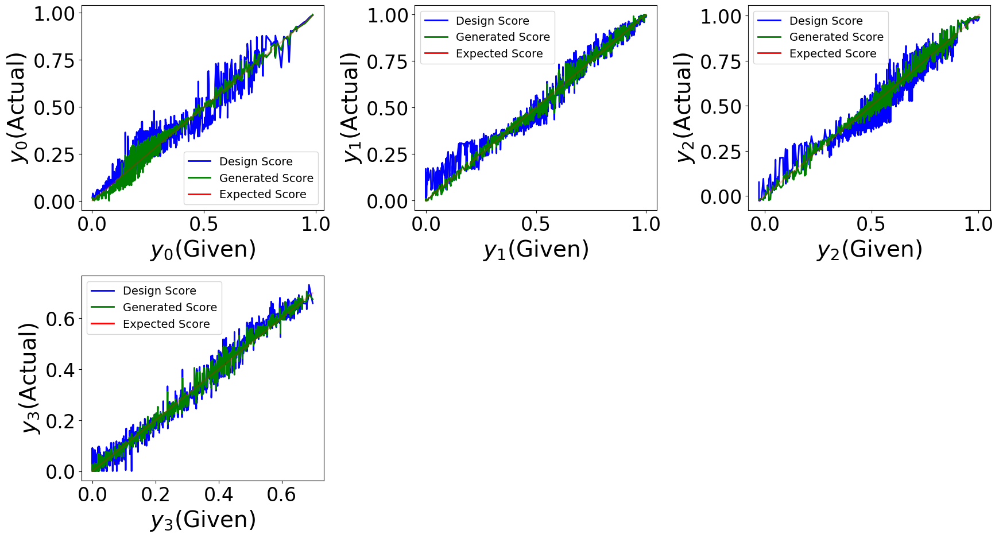

Hypervolume (100th): 20.901099
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.242877
pf Hypervolume: 21.338363
GD: 0.042984588004885256
GD+: 0.028321264767393817
IGD: 0.0573307355869742
IGD+: 0.02573849091271956
L2 dist between design score and given y: 2.327078056885943
L2 dist between generated and given y: 1.2308507813740404
Spread for y_cand: 0.5459609967883007
Spread for y_gen: 0.5062711870927625
****************************************Seed: 43*********************************************************


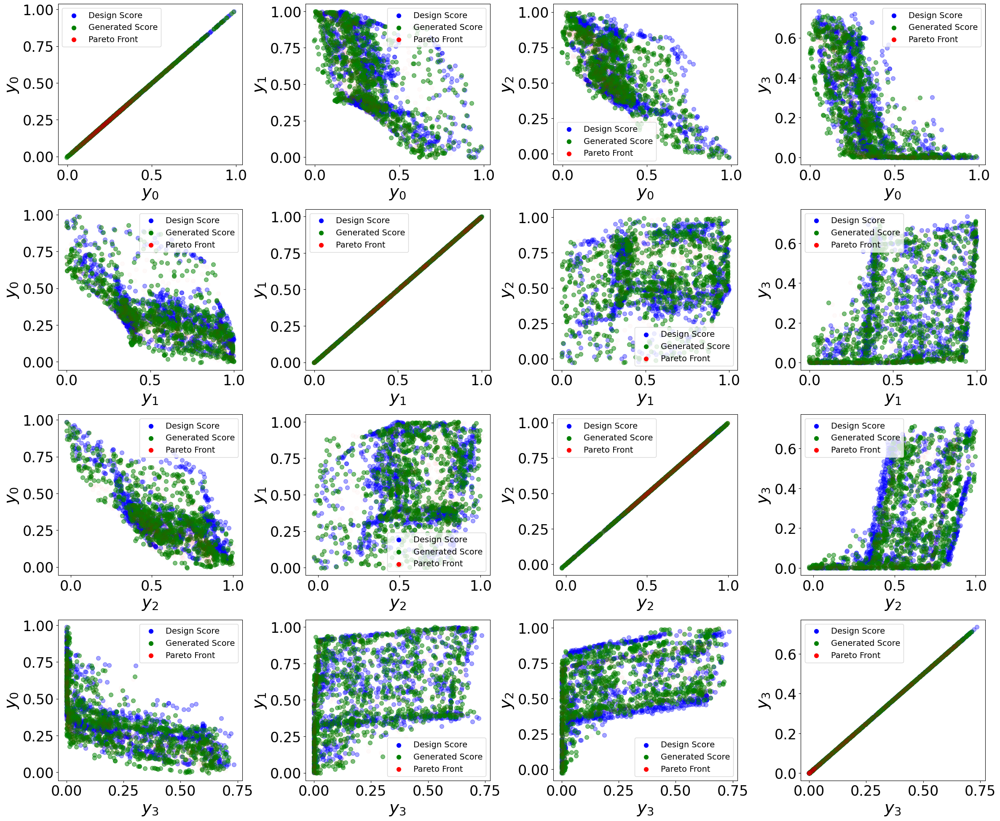

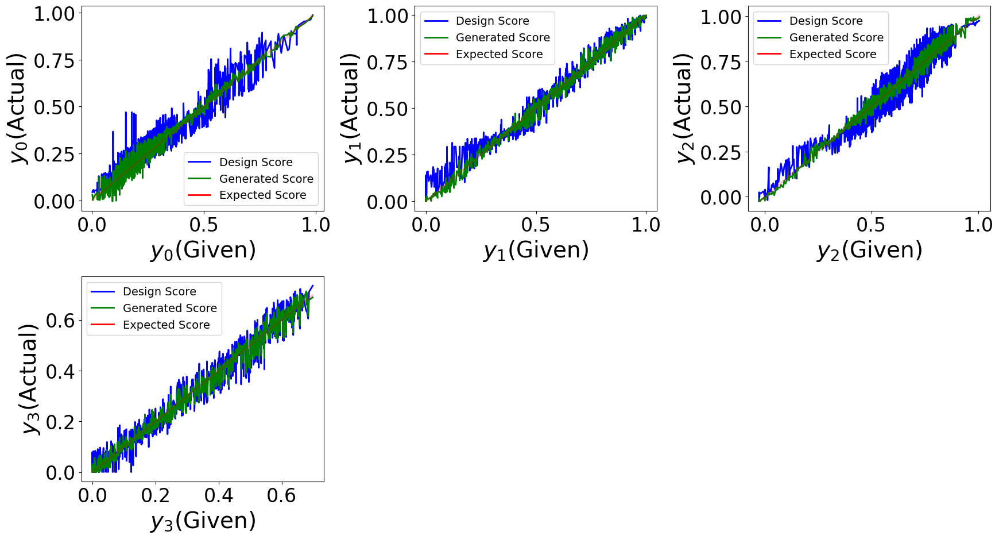

Hypervolume (100th): 20.795790
Hypervolume (D(best)): 0.000000
Ideal Hypervolume: 23.425600
y_given Hypervolume: 21.242877
pf Hypervolume: 21.338363
GD: 0.05036819458464299
GD+: 0.037037270217403634
IGD: 0.06340751974545748
IGD+: 0.03162145371737583
L2 dist between design score and given y: 2.478207787469279
L2 dist between generated and given y: 1.0671424008556585
Spread for y_cand: 0.48429709264756354
Spread for y_gen: 0.5149363236171773


In [ ]:
#This cell is to conduct conditional generation  with k = 1
if config['augment']:
    pf = task.problem.get_pareto_front() 
    if config['normalize_ys']:
        pf = task.normalize_y(pf)
    y_min = np.minimum(y_min, pf.min(axis=0))
    y_max = np.maximum(y_max, pf.max(axis=0))
    clip_min = torch.tensor(np.concatenate((x_min, y_min)))#x_lbound
    clip_max = torch.tensor(np.concatenate((x_max, y_max)))#x_ubound
else:
    clip_min = torch.tensor(x_min)
    clip_max = torch.tensor(x_max)
print(clip_dic)

config['simple_clip'] = True
# clip_min = - torch.ones_like(clip_min)*0.1
clip_dic = {'simple_clip': config['simple_clip'], 'clip_min': clip_min , 'clip_max': clip_max}
print(clip_dic)

# y_given_list  = np.linspace(0.1, 15, 100)
with fixed_random_seed(1000):
    if len(pf)<100:
        rand_idx = list(range(len(pf)))
    else:
        rand_idx = np.random.choice(len(pf), 1000, replace=False)
y_given_list =  pf[rand_idx]
num_samples = 1000

num_steps = 200
inference_scaling_bool = True
duplicated_time = 64
description = 'resampling_nsmc'
kkk=1

seed_list = [40, 41, 42, 43]
HV_list = []
IGD_list = []

import pickle

for seed in seed_list:
    print(f"****************************************Seed: {seed}*********************************************************")
    xy_pred = {f'{n}': None for n in range(num_samples)}
    xy_scores = {f'{n}': None for n in range(num_samples)}

    all_res = {"y_given_list":y_given_list}
    all_res['denoising_step'] = num_steps
    all_res['inference_scaling_bool'] = inference_scaling_bool
    all_res['duplicated_time'] = duplicated_time
    all_res['shot_num'] = kkk 
    all_res.update(clip_dic)

    for i in y_given_list:
        y_given = torch.tensor(i) 
        res = mango_eval(
            task=task,
            forwardmodel=model,
            inverse_model=inverse_model,
            # hidden_size=config['hidden_size'],
            device='auto',
            num_samples= config['num_solutions'],
            seed=seed,
            logging_dir=logging_dir,
            ckpt_dir=config['model_save_dir'],
            augment=config['augment'],
            clip_dic=clip_dic,
            gamma=0,
            gen_condition=y_given,
            guidance=True,
            num_steps=num_steps,
            inference_scaling_bool=inference_scaling_bool,
            duplicated_time=duplicated_time,
        )
        for num_samples1 in range(res['x'].shape[0]):
            if xy_pred[f'{num_samples1}'] is None:
                xy_pred[f'{num_samples1}'] = res['x'][num_samples1]
                # xy_scores[f'{num_samples}'] = res['y_scores'][num_samples]
            else:
                xy_pred[f'{num_samples1}'] = np.vstack((xy_pred[f'{num_samples1}'], res['x'][num_samples1]))
                # xy_scores[f'{num_samples}'] = np.vstack((xy_scores[f'{num_samples}'], res['y_scores'][num_samples]))

        all_res[f'y_given_{i}'] = res

    #save all_res
    file_path = os.path.join(logging_dir, f"cond_{description}_all_res_shot{kkk}_seed{seed}.pkl")
    with open(file_path, 'wb') as f:
        pickle.dump(all_res, f)

    #get best result
    x_opt_cand, y_cand, y_gen, valid_num = get_best_result(task, res, xy_pred, y_given_list, clip_max, clip_min, kkk, config)

    np.save(f'{logging_dir}/cond_{description}_res_x_opt_cand_shot{kkk}_seed{seed}.npy', x_opt_cand)
    np.save(f'{logging_dir}/cond_{description}_res_y_cand_shot{kkk}_seed{seed}.npy', y_cand)
    np.save(f'{logging_dir}/cond_{description}_res_y_gen_shot{kkk}_seed{seed}.npy', y_gen)
 

    #plot scatterr
    plot_scatter(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
    #plot line
    plot_line(y_cand, y_gen, y_given_list, description, logging_dir, kkk, seed)
    #save indicators
    save_indicators(HV_list, IGD_list, y_cand, y_gen, y_given_list, pf, description, logging_dir, kkk, seed, config, task)

In [ ]:
print(f"Average Hypervolume: {np.mean(HV_list):.4f} ± {np.std(HV_list):.4f}")
print(f"Average IGD: {np.mean(IGD_list):.4f} ± {np.std(IGD_list):.4f}")

Average Hypervolume: 20.8952 ± 0.0598
Average IGD: 0.0593 ± 0.0030
